### Popular Track prediction and recommendation

Objective: This project's objective is to predict the popularity of music in differenct Indian languages using Machine Learning techniques and also, recommending the music based on the selected music features.

### 1. Data collection / get data

About Dataset

The dataset contains Top Spotify Songs from 2000 to 2023 were used to evaluate popular songs and anticipate their popularity.The collection of datasets which includes various languages such as Telugu, Hindi, Urdu, Bengali, Gujarati, Marathi, Bhojpuri, Tamil, Kannada, Punjabi, Malayalam, Assamese, Odia, Old, Rajasthani, and Kannada as the Indian language dataset.The datasets contains over 41,356 rows with 19 columns.

About the files:-

Meta songs dataset for past 23 years.The following attributes are added.

1.Popularity:Express a song’s popularity as a percentage or a number on a scale of 1-100.

2.Danceability: A track’s danceability rating, ranging from 0.0 to 1.0, reflects its suitability for dancing based on factors like pace, rhythm stability, beat strength, and overall regularity.

3.Duration(ms): The track's duration must be very brief, measured in milliseconds.

4.Energy:A perceptual measure of intensity and activity, ranging from 0.0 to 1.0.

5.Instrumentalness: In this context, the song's lyrics treat sounds like "Ooh" and "Aah" as instruments. On the scale, their Value must fall between 0.0 and 1.0.

6.Key:The song’s tonal center is expressed numerically. For example, C corresponds to 1, C# to 2, and so on.

7.Liveliness:This element gauges whether an audience was present during the song’s recording. Higher liveness scores suggest a greater likelihood that the song was performed live.

8.Loudness(dB): The overall loudness of a track should be in average decibels.

9.Mode: Mode indicates the modality (major or minor) characteristic of a track depending on its key value, this is the type of scale from which its melodic content is derived or can say how melodic the song is.

10.Speechiness:This attribute gauges how closely a recording resembles speech. Values range from 0.0 to 1.0, with higher values indicating a more speech-like quality.

11.Tempo:The song’s pace, expressed in beats per minute (BPM), is closely tied to its typical beat duration.

12.Time_Signature: A track's estimated annual time signature is referred to as a time signature.

13.Valence(float): Every track's positiveness is determined by its valence measurements, which range from 0 to 1 as with other qualities (high or low).

In [1]:
# Downloading dataset from kaggle
import opendatasets as od
import os
import pandas as pd

# Downloading dataset directory from kaggle
dataset = od.download("https://www.kaggle.com/datasets/gayathripullakhandam/spotify-indian-languages-datasets")

# List of datasets in the directory
datasets = os.listdir("spotify-indian-languages-datasets")

# Concatenation of all the datasets in single file
main_df = pd.DataFrame()
for dataset in datasets:
    df = pd.read_csv("spotify-indian-languages-datasets/"+f"{dataset}")
    main_df = main_df._append(df)

Skipping, found downloaded files in ".\spotify-indian-languages-datasets" (use force=True to force download)


In [2]:
# Storing original copy of dataset
original_df = main_df.copy()

In [3]:
# Brief view of dataset
main_df.head()

,song_name,singer,singer_id,duration,language,released_date,danceability,acousticness,energy,liveness,loudness,speechiness,tempo,mode,key,Valence,time_signature,popularity,Stream
0,Namore Kothia,Bhupen Hazarika|Anju Devi,/artist/dr-bhupen-hazarika-2|/artist/anju-devi,07:11,Assamese,02-07-2005,0.77,0.670,0.250,0.471,-7.404,0.0152,149.977,0.0,9.0,0.0700,4.0,40.0,9195112.0
1,Jai A Kanu,Khagen Mahanta,/artist/khagen-mahanta,04:41,Assamese,03-09-2005,0.17,0.240,0.557,0.906,-6.357,0.0100,150.031,0.0,9.0,0.0454,4.0,62.0,5008223.0
2,Tuamaki Roana,sibcharan das,/artist/sibcharan-das,03:11,Assamese,12-06-2009,0.88,0.628,0.295,0.257,-2.865,0.0100,149.964,0.0,9.0,0.0100,4.0,71.0,662879.0
3,Surat Magan Bhayal Rati,Jayanta Hazarika,/artist/jayanta-hazarika,04:02,Assamese,11-04-2015,0.29,0.740,0.288,0.450,-5.943,0.0540,149.962,0.0,1.0,0.0310,4.0,82.0,9514268.0
4,Buku Ham Ham Kore,Bhupen Hazarika,/artist/dr-bhupen-hazarika-2,03:23,Assamese,09-11-2019,0.05,0.284,0.692,0.571,-2.519,0.0570,153.945,0.0,10.0,0.0129,4.0,54.0,1580562.0


In [4]:
main_df.tail()

,song_name,singer,singer_id,duration,language,released_date,danceability,acousticness,energy,liveness,loudness,speechiness,tempo,mode,key,Valence,time_signature,popularity,Stream
3111,Salam,Farhat Shuja,/artist/farhat-shuja,10:04,Urdu,06-03-2021,0.89,0.472,0.162,0.130,-11.736,0.0078,177.068,0.0,9.0,0.0053,4.0,56.0,4531481.0
3112,Thumri Tilang - Sajia Akeli Dukh De,Badar Uz Zaman|Qamar Uz Zaman,/artist/badar-uz-zaman-1|/artist/qamar-uz-zaman-1,06:11,Urdu,02-07-2022,0.78,0.940,0.650,0.490,-3.579,0.0931,139.973,1.0,2.0,0.0353,4.0,49.0,6477249.0
3113,Sanwar Sanwar Kar,Mumtaz Shirazi,/artist/mumtaz-shirazi,04:45,Urdu,04-04-2005,0.03,0.679,0.829,0.292,-9.689,0.0880,129.983,1.0,9.0,0.0925,4.0,95.0,7873636.0
3114,Jo Teri Sana Mein,Muzaffar Warisi,/artist/muzaffar-warisi,06:16,Urdu,10-06-2020,0.35,0.530,0.540,0.390,-12.340,0.0012,140.025,0.0,7.0,0.0300,4.0,91.0,10355833.0
3115,Lucky Seven & Lucky Thirteen,Karim Shahab ud Din,/artist/karim-shahab-ud-din,03:04,Urdu,11-06-2019,0.50,0.396,0.933,0.957,-7.100,0.0164,145.047,0.0,9.0,0.0370,4.0,51.0,7009382.0


### 2. Exploratory Data Analysis and visualization

In [5]:
# 1. Shape of dataset
main_df.shape

(35001, 19)

In [6]:
# 2. Reset index
main_df = main_df.reset_index(drop=True)

In [7]:
# 3. Columns present in the dataset
main_df.columns

Index(['song_name', 'singer', 'singer_id', 'duration', 'language',
       'released_date', 'danceability', 'acousticness', 'energy', 'liveness',
       'loudness', 'speechiness', 'tempo', 'mode', 'key', 'Valence',
       'time_signature', 'popularity', 'Stream'],
      dtype='object')

In [8]:
#4. Rearranging columns to get popularity at the first
main_df = main_df[['popularity', 'song_name', 'singer', 'singer_id', 'duration', 'language',
       'released_date', 'danceability', 'acousticness', 'energy', 'liveness',
       'loudness', 'speechiness', 'tempo', 'mode', 'key', 'Valence',
       'time_signature', 'Stream']]

In [9]:
# 5. Brief view of dataset
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35001 entries, 0 to 35000
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   popularity      34999 non-null  float64
 1   song_name       35001 non-null  object 
 2   singer          35001 non-null  object 
 3   singer_id       35001 non-null  object 
 4   duration        35001 non-null  object 
 5   language        35001 non-null  object 
 6   released_date   35001 non-null  object 
 7   danceability    35000 non-null  float64
 8   acousticness    35000 non-null  float64
 9   energy          35000 non-null  float64
 10  liveness        35000 non-null  float64
 11  loudness        35000 non-null  float64
 12  speechiness     35000 non-null  float64
 13  tempo           34999 non-null  float64
 14  mode            34999 non-null  float64
 15  key             34999 non-null  float64
 16  Valence         34999 non-null  float64
 17  time_signature  34999 non-null 

All the data types of the columns are consistent other than release date, which needs to be converted to datetime type.

In [10]:
# 6. Presence of null values
main_df.isna().sum()

popularity        2
song_name         0
singer            0
singer_id         0
duration          0
language          0
released_date     0
danceability      1
acousticness      1
energy            1
liveness          1
loudness          1
speechiness       1
tempo             2
mode              2
key               2
Valence           2
time_signature    2
Stream            2
dtype: int64

In [11]:
# Nan values are less and dropping na values
main_df = main_df.dropna()
main_df.isna().sum()

popularity        0
song_name         0
singer            0
singer_id         0
duration          0
language          0
released_date     0
danceability      0
acousticness      0
energy            0
liveness          0
loudness          0
speechiness       0
tempo             0
mode              0
key               0
Valence           0
time_signature    0
Stream            0
dtype: int64

In [12]:
# 7. Presence of duplicate entries
main_df.duplicated().sum()

0

In [13]:
# 8. Dtype consistency
# Release date dtype needs to be converted to datetime type
import datetime

main_df['released_date'] = pd.to_datetime(main_df['released_date'], dayfirst=True)
main_df.released_date.head()

0   2005-07-02
1   2005-09-03
2   2009-06-12
3   2015-04-11
4   2019-11-09
Name: released_date, dtype: datetime64[ns]

In [14]:
main_df.duration.str.split(':', expand=True)

,0,1,2
0,07,11,None
1,04,41,None
2,03,11,None
3,04,02,None
4,03,23,None
...,...,...,...
34996,10,04,None
34997,06,11,None
34998,04,45,None
34999,06,16,None


In [15]:
# Duration needs to converted to minutes or seconds
# splitting duration
main_df[['duration_minutes', 'duration_seconds', 'None']] = main_df.duration.str.split(':', expand=True)

# Dropping redundant columns
main_df = main_df.drop(columns=['duration', 'None'], axis=1)

# Dtype conversion
main_df = main_df.astype({'duration_minutes':'int', 'duration_seconds':'int'})

In [16]:
# 9. Statistical summary of data
main_df.describe(exclude=['object', 'datetime'])

,popularity,danceability,acousticness,energy,liveness,loudness,speechiness,tempo,mode,key,Valence,time_signature,Stream,duration_minutes,duration_seconds
count,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,34999.000000,3.499900e+04,34999.000000,34999.000000
mean,62.677848,0.502778,0.502286,0.500229,0.498238,-8.011346,0.050018,148.541665,0.555302,5.306266,0.050510,3.999657,5.719169e+06,4.446498,26.147404
std,21.976121,0.288161,0.288948,0.288532,0.289309,3.476914,0.029137,23.995467,0.496939,3.667202,0.034392,0.212070,3.301376e+06,3.733575,17.315579
min,25.000000,0.000000,0.000000,0.000000,0.000000,-14.000000,0.000000,57.967000,0.000000,0.000000,0.000000,3.000000,1.120000e+03,0.000000,0.000000
25%,44.000000,0.260000,0.250000,0.253000,0.248000,-11.046000,0.025000,131.132500,0.000000,1.000000,0.025000,4.000000,2.877795e+06,3.000000,12.000000
50%,63.000000,0.500000,0.501000,0.500000,0.500000,-8.007000,0.050000,145.078000,1.000000,6.000000,0.050000,4.000000,5.741071e+06,4.000000,25.000000
75%,82.000000,0.750000,0.750000,0.749000,0.750000,-4.970500,0.075000,164.289000,1.000000,8.000000,0.075300,4.000000,8.572462e+06,5.000000,40.000000
max,100.000000,1.000000,1.000000,1.000000,1.000000,-2.000000,0.375000,220.290000,1.000000,11.000000,0.952000,43.000000,3.286358e+07,59.000000,59.000000


Dataset needs to be standardized before modeling since mean across features varies and features have varying range of values within them.

In [17]:
# 10. Visualizations
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

In [18]:
# Numerical columns
num_columns = main_df.select_dtypes(include=['int', 'float']).columns
cat_columns = main_df.select_dtypes(include=['object']).columns

print("Numerical columns: ", num_columns)
print()
print("Categorical columns: ", cat_columns)

Numerical columns:  Index(['popularity', 'danceability', 'acousticness', 'energy', 'liveness',
       'loudness', 'speechiness', 'tempo', 'mode', 'key', 'Valence',
       'time_signature', 'Stream', 'duration_minutes', 'duration_seconds'],
      dtype='object')

Categorical columns:  Index(['song_name', 'singer', 'singer_id', 'language'], dtype='object')


c:\Users\umesh\anaconda3\envs\DeepLearning\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\umesh\anaconda3\envs\DeepLearning\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\umesh\anaconda3\envs\DeepLearning\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Users\umesh\anaconda3\envs\DeepLearning\lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. 

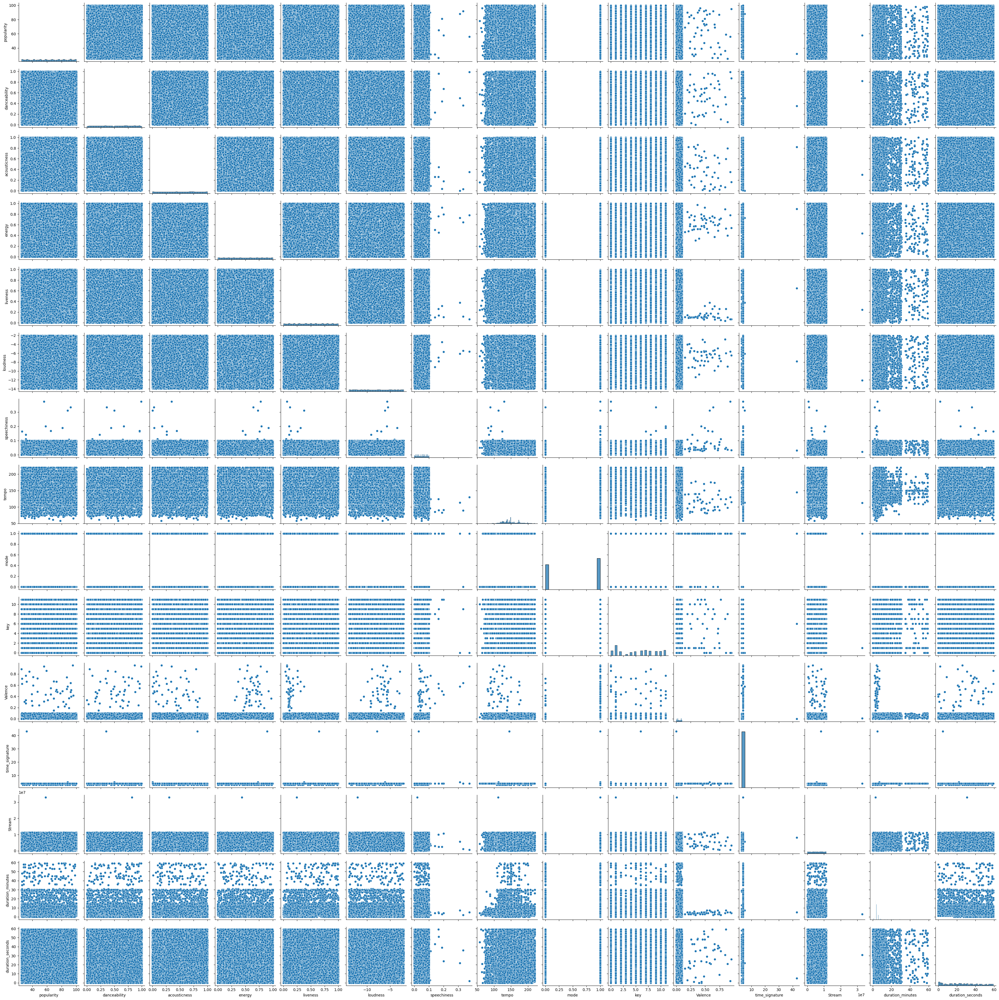

In [19]:
# Distribution
sns.pairplot(main_df[num_columns])
plt.show()

In [20]:
# Outliers presence and distribution

for col in num_columns:
    fig = make_subplots(rows=1, cols=2, subplot_titles=[f'{col} Histogram', f'{col} Boxplot'])
    fig.add_trace(go.Histogram(x=main_df[col]), row=1, col=1)
    fig.add_trace(go.Box(x=main_df[col]), row=1, col=2)
    fig.update_layout(title=f"{col}", title_x=0.5)
    fig.show()

In [21]:
# Correlation
fig=px.imshow(main_df[num_columns].corr(),text_auto=True,height=800,width=800,color_continuous_scale=px.colors.sequential.Greens,aspect='auto',title='<b>pairwise correlation of columns')
fig.update_layout(title_x=0.5)
fig.show()

In [22]:
# Correlation matrix
main_df[num_columns].corrwith(main_df['popularity'])

popularity          1.000000
danceability       -0.000143
acousticness        0.002816
energy             -0.003925
liveness           -0.005386
loudness           -0.004976
speechiness        -0.006128
tempo               0.002904
mode               -0.000293
key                -0.005217
Valence            -0.003244
time_signature     -0.008025
Stream              0.008267
duration_minutes   -0.008953
duration_seconds   -0.000704
dtype: float64

Observation:
1. No significant correlation observed between popularity and other features.

In [23]:
# Checking for correlation with varying popularity
for pop in range(50, 100, 10):
    print(f"Correlateion when Popularity >= {pop}")
    df = main_df[main_df.popularity >= pop]
    print(df[num_columns].corrwith(df[num_columns].popularity))
    print()

Correlateion when Popularity >= 50
popularity          1.000000
danceability       -0.009351
acousticness        0.014308
energy              0.006732
liveness           -0.005677
loudness            0.005403
speechiness        -0.004226
tempo               0.003213
mode               -0.004006
key                -0.002857
Valence             0.001291
time_signature      0.001554
Stream              0.010884
duration_minutes    0.000059
duration_seconds    0.003291
dtype: float64

Correlateion when Popularity >= 60
popularity          1.000000
danceability        0.003577
acousticness        0.007323
energy              0.003612
liveness           -0.013108
loudness            0.009063
speechiness         0.004013
tempo               0.002869
mode                0.001473
key                -0.003189
Valence             0.002667
time_signature      0.001001
Stream              0.016127
duration_minutes   -0.006613
duration_seconds    0.010291
dtype: float64

Correlateion when Popularity

### 3. Data cleaning

Null values dropped and duplicates removed. Data is clean.

### 4. Feature engineering 

In [24]:
# Creating duration columns by combining minutes and seconds in seconds.
main_df['duration'] = main_df.apply(lambda row: row.duration_minutes * 60 + row.duration_seconds, axis=1)
main_df = main_df.drop(columns=['duration_minutes', 'duration_seconds'], axis=1)

### 5. Feature selection

In [25]:
# Dropped 'song_name', 'singer', 'singer_id', 'language', 'released_date', and stream
selected_features = ['popularity', 'danceability', 'acousticness', 'energy', 'liveness',
       'loudness', 'speechiness', 'tempo', 'mode', 'key', 'Valence',
       'time_signature', 'duration']

In [26]:
# Train test splitting 
X = main_df[selected_features].iloc[:,1:].values
y = main_df[selected_features].iloc[:,0].values

In [27]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42, shuffle=True)

In [28]:
# Split data shape
X_train.shape, y_train.shape

((27999, 12), (27999,))

In [29]:
# Normalization of data in the range 0 to 1
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

### 6. Model selection

In [30]:
# Linear regression for prediction
from sklearn.linear_model import LinearRegression, Lasso, ridge_regression
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

# Linear model
lr_model = LinearRegression()

# Model fitting 
lr_model.fit(X_train_scaled, y_train)
lr_predictions = lr_model.predict(X_test_scaled)

# Evaluation
rmse = r2_score(y_test, lr_predictions)
mse = mean_squared_error(y_test, lr_predictions)
print("Performance of model: ")
print("RMSE value: ", rmse)
print("Mean squared error: ", mse)

# regression coefficients
print('Coefficients: ', lr_model.coef_)

# variance score: 1 means perfect prediction
print('Variance score: {}'.format(lr_model.score(X_test_scaled, y_test)))

Performance of model: 
RMSE value:  -0.0006974443632525862
Mean squared error:  475.639928101528
Coefficients:  [  0.18699602   0.50821052  -0.48184583  -0.46742681  -0.25128023
  -1.69906738  -0.20898514  -0.12173724  -0.60932082  -2.25931786
 -34.17881977  -3.79094443]
Variance score: -0.0006974443632525862


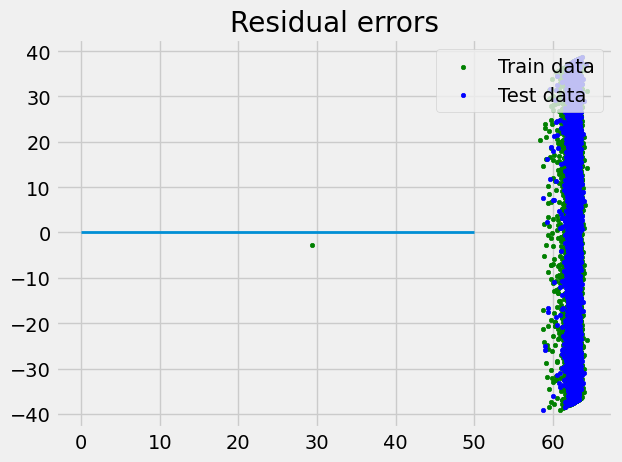

In [31]:
import matplotlib.pyplot as plt
# plot for residual error

# setting plot style
plt.style.use('fivethirtyeight')

# plotting residual errors in training data
plt.scatter(lr_model.predict(X_train_scaled),
            lr_model.predict(X_train_scaled) - y_train,
            color="green", s=10,
            label='Train data')

# plotting residual errors in test data
plt.scatter(lr_predictions,
            lr_predictions - y_test,
            color="blue", s=10,
            label='Test data')

# plotting line for zero residual error
plt.hlines(y=0, xmin=0, xmax=50, linewidth=2)

# plotting legend
plt.legend(loc='upper right')

# plot title
plt.title("Residual errors")

# method call for showing the plot
plt.show()

In [32]:
# Lasso regression
lasso_model = Lasso()
# Model fitting 
lasso_model.fit(X_train_scaled, y_train)
lasso_predictions = lasso_model.predict(X_test_scaled)

# Evaluation
rmse = r2_score(y_test, lasso_predictions)
mse = mean_squared_error(y_test, lasso_predictions)
print("Performance of model: ")
print("RMSE value: ", rmse)
print("Mean squared error: ", mse)

# regression coefficients
print('Coefficients: ', lasso_model.coef_)

# variance score: 1 means perfect prediction
print('Variance score: {}'.format(lasso_model.score(X_test_scaled, y_test)))

Performance of model: 
RMSE value:  -1.6509381814966417e-05
Mean squared error:  475.31627396666727
Coefficients:  [ 0.  0. -0. -0. -0. -0. -0. -0. -0. -0. -0. -0.]
Variance score: -1.6509381814966417e-05


In [33]:
# Ridge regression
from sklearn.linear_model import Ridge

ridge_model = Ridge()
# Model fitting 
ridge_model.fit(X_train_scaled, y_train)
ridge_predictions = ridge_model.predict(X_test_scaled)

# Evaluation
rmse = r2_score(y_test, ridge_predictions)
mse = mean_squared_error(y_test, ridge_predictions)
print("Performance of model: ")
print("RMSE value: ", rmse)
print("Mean squared error: ", mse)

# regression coefficients
print('Coefficients: ', ridge_model.coef_)

# variance score: 1 means perfect prediction
print('Variance score: {}'.format(ridge_model.score(X_test_scaled, y_test)))

Performance of model: 
RMSE value:  -0.0006868646785855859
Mean squared error:  475.6348994882517
Coefficients:  [  0.18777448   0.50592167  -0.48421427  -0.46835628  -0.25125741
  -1.68665226  -0.20700727  -0.1227406   -0.61002459  -2.15691384
 -16.87787673  -3.75608926]
Variance score: -0.0006868646785855859


In [34]:
# Random forest regressor fitting
from sklearn.ensemble import RandomForestRegressor

rf_model = RandomForestRegressor()

# Model fitting 
rf_model.fit(X_train_scaled, y_train)
rf_predictions = rf_model.predict(X_test_scaled)

# Evaluation
rmse = r2_score(y_test, rf_predictions)
mse = mean_squared_error(y_test, rf_predictions)
print("Performance of model: ")
print("RMSE value: ", rmse)
print("Mean squared error: ", mse)

Performance of model: 
RMSE value:  -0.017881030806864873
Mean squared error:  483.80743154285716


Negative rmse value shows non linear relationship in dataset

In [35]:
# Exploring non-linear relationship
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=2)

X_train_scaled_poly = poly.fit_transform(X_train_scaled)
X_test_scaled_poly = poly.transform(X_test_scaled)

# Linear model
lr_model_poly = LinearRegression()

# Model fitting 
lr_model_poly.fit(X_train_scaled_poly, y_train)
lr_predictions_poly = lr_model.predict(X_test_scaled)

# Evaluation
rmse = r2_score(y_test, lr_predictions_poly)
mse = mean_squared_error(y_test, lr_predictions_poly)
print("Performance of model: ")
print("RMSE value: ", rmse)
print("Mean squared error: ", mse)

# regression coefficients
print('Coefficients: ', lr_model_poly.coef_)

# variance score: 1 means perfect prediction
print('Variance score: {}'.format(lr_model_poly.score(X_test_scaled_poly, y_test)))

Performance of model: 
RMSE value:  -0.0006974443632525862
Mean squared error:  475.639928101528
Coefficients:  [-4.52570567e-12 -3.86505436e+01  1.26119283e+01 -8.93381973e+00
  1.98588847e+00 -8.38677050e+00 -5.00117573e+01 -3.55822813e+01
 -3.27223845e+14  2.23046875e+01  5.02773438e+01 -1.19978337e+03
  6.76074219e+00 -1.46875000e+00 -2.08593750e+00 -1.43359375e+00
  2.50976562e-01  2.68750000e+00 -1.82031250e+00  1.43359375e+00
  1.34375000e+00 -2.07226562e+00  1.36132812e+01  1.57946960e+03
 -3.36425781e+00 -1.14843750e+00 -2.26562500e-01 -1.09375000e+00
  3.62500000e+00  7.34375000e-01 -1.36718750e+00 -7.34375000e-01
  1.06250000e+00  1.41718750e+01 -4.19578979e+02 -7.02343750e+00
 -1.87500000e-01  1.23437500e+00 -6.83593750e-01  2.06835938e+00
  2.00000000e+00 -1.54296875e+00 -1.57031250e+00  1.00742188e+01
  3.80009277e+02 -5.75097656e+00  1.87500000e+00  1.33593750e+00
  4.27343750e+00 -2.75000000e+00  1.10742188e+00 -4.29687500e-01
 -2.08847656e+01 -1.28639137e+02 -3.8164062

Polynomial regression also gives negative rmse value. Predictive model cannot be fitted for predicting popularity of song using given features.

Observation:
1. The Spotify indian languages songs dataset has uniform distribution and not showing any observable relationship of features with target feature  ie popularity.
2. Dataset requires additional information to be captured ie new feature information which exihibits observable relationship with target.